In [15]:
%reload_ext sql
%config SqlMagic.autocommit=False
%config SqlMagic.autolimit=0
%config SqlMagic.autopandas=True
%config SqlMagic.displaylimit=200
%sql trino://localhost:9090/cuebiq/

import pandas as pd
import yaml
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import os
from pyhive import trino
import pydeck as pdk
from typing import List
import json
import copy
import itertools
from pyquadkey2 import quadkey
from pyquadkey2.quadkey import TileAnchor, QuadKey
from h3 import h3
import seaborn as sns
from keplergl import KeplerGl
from datetime import datetime, timedelta
import math
import pickle

os.environ['MAPBOX_API_KEY'] = "INSERT YOUR MAPBOX TOKEN HERE"
pd.set_option('display.max_colwidth', 0)
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import warnings
warnings.filterwarnings('ignore')

In [16]:
# SQL engine
from trino.dbapi import connect 
from sqlalchemy import create_engine

class TrinoEngine():
    def __init__(self):
        conn = connect(
            host="localhost",
            port=9090,
            catalog="cuebiq"
        )
        self.cur = conn.cursor()
        self.engine = create_engine("trino://localhost:9090/cuebiq/")
    
    def execute_statement(self, query:str) -> list:
        """
        Create and drop statements.
        """
        self.cur.execute(query)
        return self.cur.fetchall()
    
    def read_sql(self, query:str) -> pd.DataFrame: 
        """
        Select and insert into operations.
        """
        return pd.read_sql(query, self.engine)

sql_engine = TrinoEngine()

In [18]:
def compute_scaled_entropy(row,col1,col2,col3,col4,col5,col6):
    sum_nominator = 0
    for item in [row[col1],row[col2],row[col3],row[col4],row[col5],row[col6]]:
        if item != 0:
            sum_nominator += item*(np.log(1/item))
    row['scaled_entropy'] = sum_nominator/np.log(6)
    return row

def identify_max_col(row,col1,col2,col3,col4,col5,col6):
    dominant = max([row[col1],row[col2],row[col3],row[col4],row[col5],row[col6]])
    if dominant == row[col1]: row['dominant_race'] = col1
    if dominant == row[col2]: row['dominant_race'] = col2
    if dominant == row[col3]: row['dominant_race'] = col3
    if dominant == row[col4]: row['dominant_race'] = col4
    if dominant == row[col5]: row['dominant_race'] = col5
    if dominant == row[col6]: row['dominant_race'] = col6
    return row

def extract_dominant_group(df):
    df.loc[df['scaled_entropy']<=0.3707,'class'] = 'low diversity'
    df.loc[df['R_White']>=0.8,'class'] = 'low diversity'
    df.loc[df['R_HispanicLatinx']>=0.8,'class'] = 'low diversity'
    df.loc[df['R_AfricanAmerican']>=0.8,'class'] = 'low diversity'
    df.loc[df['R_AmericanIndianAlaska']>=0.8,'class'] = 'low diversity'
    df.loc[df['R_Asian']>=0.8,'class'] = 'low diversity'
    df.loc[df['R_Other']>=0.8,'class'] = 'low diversity'

    df.loc[(df['scaled_entropy']>=0.7414)&(df['R_White']<0.45)
                             &(df['R_HispanicLatinx']<0.45)&(df['R_AfricanAmerican']<0.45)
                             &(df['R_AmericanIndianAlaska']<0.45)&(df['R_Asian']<0.45)
                             &(df['R_Other']<0.45)
                             ,'class'] = 'high diversity'

    df['class'] = df['class'].fillna('moderate diversity')
    print(df['class'].value_counts())
    
    df = df.apply(lambda x:identify_max_col(x,'R_White','R_HispanicLatinx','R_AfricanAmerican','R_AmericanIndianAlaska','R_Asian','R_Other'), axis=1)
    
    df['class_dominant'] = df['dominant_race'] + '_' + df['class']
    df.loc[df['class']=='high diversity','class_dominant'] = 'high diversity'
    print(df.class_dominant.value_counts())
    return df

# Descriptive statistics for the CEUS paper

In [13]:
%%time
## this code snippet is only for descriptive statistics and no need to run in the future

weekday = False #True, False
# date = ['20220301_20220308','20220309_20220316','20220317_20220323','20220324_20220331']
date = ['20190301_20190308','20190309_20190316','20190317_20190323','20190324_20190331']
# weekendays = [20220305,20220306,20220312,20220313,20220319,20220320,20220326,20220327]
weekendays = [20190302,20190303,20190309,20190310,20190316,20190317,20190323,20190324,20190330,20190331]
sum_df_race = pd.DataFrame()
for d in date:
    df_visit_LA = pd.read_pickle("../output/LA_visit_with_poiCategory"+str(d)+".pkl")
    if weekday:#1. select weekdays
        df_visit_LA = df_visit_LA[~df_visit_LA.event_date.isin(weekendays)]        
    else:#2. select weekends
        df_visit_LA = df_visit_LA[df_visit_LA.event_date.isin(weekendays)] 
    df_visit_LA.drop_duplicates(keep='last', inplace=True) 
    df_visit_LA_race = pd.merge(df_visit_LA, df_indi_home_loc_race,on='cuebiq_id')  
    sum_df_race = sum_df_race.append(df_visit_LA_race)
print('total visit records:',sum_df_race.shape[0])
print('total unique persons:',sum_df_race.cuebiq_id.unique().shape[0])
print('total unique POIs:',sum_df_race.place_id.unique().shape[0])    

total visit records: 1617700
total unique persons: 226710
total unique POIs: 31382
CPU times: user 12.9 s, sys: 1.16 s, total: 14 s
Wall time: 14 s


# Main code

In [6]:
# %%time
# sql_engine.read_sql(f"desc cuebiq.paas_cda_pe_v3.poi")

In [19]:
df_poi_cat = pd.read_pickle("../output/LA_POI_category.pkl") # all POI in LA
df_indi_home_loc_race = pd.read_pickle("../output/CA_Individual_race_composition_20190301.pkl")
print(df_indi_home_loc_race.shape[0]) # all cubiq individuals who live in California: 1600238
df_indi_home_loc_race.head(1)

1086135


,cuebiq_id,home_block,population,R_White,R_HispanicLatinx,R_AfricanAmerican,R_AmericanIndianAlaska,R_Asian,R_Other,devices,weight
0,1126353673,US.CA.075.025701.1,1988.0,9.677419,13.290323,1.258065,0.0,38.870968,1.032258,31,64.129032


In [7]:
# df_indi_home_loc_race_LA = pd.read_pickle("../output/LA_Individual_race_composition.pkl")
# print(df_indi_home_loc_race_LA.shape[0]) # these are LA local residents: 340912
# df_indi_home_loc_race_LA.head(1)

# 1. diversity measured by proportions of different racial populations

In [20]:
weekday = True#False, True
timeofday = 'afternoon' #morning,noon,afternoon,evening

# date = ['20220301_20220308','20220309_20220316','20220317_20220323','20220324_20220331']
date = ['20190301_20190308','20190309_20190316','20190317_20190323','20190324_20190331']
# weekendays = [20220305,20220306,20220312,20220313,20220319,20220320,20220326,20220327]
weekendays = [20190302,20190303,20190309,20190310,20190316,20190317,20190323,20190324,20190330,20190331]

option 1: distinguish between weekend and weekdays and the time of the day based on visit's start hour (Morning 5-10, Noon 11-13, Afternoon 14-17, Evening 18-24)

In [21]:
%%time
sum_df_race = pd.DataFrame()
print('weekday:',weekday,',',timeofday,'*'*10)
for d in date:
    df_visit_LA = pd.read_pickle("../output/LA_visit_with_poiCategory"+str(d)+".pkl") # POI visits in LA
    
    if weekday:#1. select weekdays
        df_visit_LA = df_visit_LA[~df_visit_LA.event_date.isin(weekendays)]        
    else:#2. select weekends
        df_visit_LA = df_visit_LA[df_visit_LA.event_date.isin(weekendays)] 
    df_visit_LA.drop_duplicates(keep='last', inplace=True)
    
    #3. differentiate morning,noon,afternoon,evening
    if timeofday == 'morning':
        df_visit_LA = df_visit_LA[(df_visit_LA.start_hour<=10)&(df_visit_LA.end_hour>=5)]
    elif timeofday == 'noon':
        df_visit_LA = df_visit_LA[(df_visit_LA.start_hour<=13)&(df_visit_LA.end_hour>=11)]
    elif timeofday == 'afternoon':
        df_visit_LA = df_visit_LA[(df_visit_LA.start_hour<=17)&(df_visit_LA.end_hour>=14)]
    elif timeofday == 'evening':
        df_visit_LA = df_visit_LA[((df_visit_LA.start_hour<=24)&(df_visit_LA.end_hour>=18))]
        # df_visit_LA = df_visit_LA[((df_visit_LA.start_hour<=24)&(df_visit_LA.end_hour>=18))|((df_visit_LA.start_hour<=4)&(df_visit_LA.end_hour>=0))]

    print('****',d,'****')
    print('visit records:',df_visit_LA.shape[0])
    print('unique persons:',df_visit_LA.cuebiq_id.unique().shape[0])
    print('unique POIs:',df_visit_LA.place_id.unique().shape[0])
    
    df_visit_LA_race = pd.merge(df_visit_LA, df_indi_home_loc_race, on='cuebiq_id')
    print("---after left join CA race---") # the counts drop because some visits were coming from outside CA
    print('visit records:',df_visit_LA_race.shape[0])
    print('unique persons:',df_visit_LA_race.cuebiq_id.unique().shape[0])
    print('unique POIs:',df_visit_LA_race.place_id.unique().shape[0])    

    sub_df_visit_LA_race = df_visit_LA_race[['place_id','R_White','R_HispanicLatinx','R_AfricanAmerican','R_AmericanIndianAlaska','R_Asian','R_Other','weight']]
    sub_df_visit_LA_race = sub_df_visit_LA_race.groupby('place_id').sum().reset_index() # groupby POI id
    sum_df_race = sum_df_race.append(sub_df_visit_LA_race)

weekday: True , afternoon **********
**** 20190301_20190308 ****
visit records: 369864
unique persons: 118693
unique POIs: 29368
---after left join CA race---
visit records: 346609
unique persons: 109270
unique POIs: 29043
**** 20190309_20190316 ****
visit records: 316838
unique persons: 109881
unique POIs: 28615
---after left join CA race---
visit records: 275335
unique persons: 94322
unique POIs: 27870
**** 20190317_20190323 ****
visit records: 331553
unique persons: 113534
unique POIs: 28909
---after left join CA race---
visit records: 276359
unique persons: 93599
unique POIs: 27981
**** 20190324_20190331 ****
visit records: 338039
unique persons: 115610
unique POIs: 28914
---after left join CA race---
visit records: 273222
unique persons: 92334
unique POIs: 27806
CPU times: user 14.7 s, sys: 2.62 s, total: 17.3 s
Wall time: 20.6 s


option 2: distinguish between weekend and weekdays only

In [48]:
# %%time

# weekday = True #False, True
# print('weekday:',weekday,',','*'*10)
# sum_df_race = pd.DataFrame()
# for d in date:
#     df_visit_LA = pd.read_pickle("../output/LA_visit_with_poiCategory"+str(d)+".pkl")
    
#     if weekday:#1. select weekdays
#         df_visit_LA = df_visit_LA[~df_visit_LA.event_date.isin(weekendays)]        
#     else:#2. select weekends
#         df_visit_LA = df_visit_LA[df_visit_LA.event_date.isin(weekendays)] 
#     df_visit_LA.drop_duplicates(keep='last', inplace=True) 

#     print('****',d,'****')
#     print('visit records:',df_visit_LA.shape[0])
#     print('unique persons:',df_visit_LA.cuebiq_id.unique().shape[0])
#     print('unique POIs:',df_visit_LA.place_id.unique().shape[0])
    
#     df_visit_LA_race = pd.merge(df_visit_LA, df_indi_home_loc_race,on='cuebiq_id')  
    
#     print("---after left join CA race---")
#     print('visit records:',df_visit_LA_race.shape[0])
#     print('unique persons:',df_visit_LA_race.cuebiq_id.unique().shape[0])
#     print('unique POIs:',df_visit_LA_race.place_id.unique().shape[0])
    
#     sub_df_visit_LA_race = df_visit_LA_race[['place_id','R_White','R_HispanicLatinx','R_AfricanAmerican','R_AmericanIndianAlaska','R_Asian','R_Other','weight']]
#     sub_df_visit_LA_race = sub_df_visit_LA_race.groupby('place_id').sum().reset_index() # groupby POI id
#     sum_df_race = sum_df_race.append(sub_df_visit_LA_race)

weekday: True , **********
**** 20190301_20190308 ****
visit records: 935090
unique persons: 190317
unique POIs: 32456
---after left join CA race---
visit records: 873968
unique persons: 172490
unique POIs: 32266
**** 20190309_20190316 ****
visit records: 804472
unique persons: 180895
unique POIs: 32052
---after left join CA race---
visit records: 699398
unique persons: 153964
unique POIs: 31702
**** 20190317_20190323 ****
visit records: 838202
unique persons: 186199
unique POIs: 32087
---after left join CA race---
visit records: 699269
unique persons: 152192
unique POIs: 31617
**** 20190324_20190331 ****
visit records: 854741
unique persons: 189324
unique POIs: 32188
---after left join CA race---
visit records: 690634
unique persons: 150017
unique POIs: 31572
CPU times: user 19.3 s, sys: 1.85 s, total: 21.1 s
Wall time: 21.1 s


option 3: merge whole month visit (voided)

In [9]:
# %%time
# date = ['20220301_20220308','20220309_20220316','20220317_20220323','20220324_20220331']
# #weekend days: 20220305,20220306,20220312,20220313,20220319,20220320,20220326,20220327
# sum_df_race = pd.DataFrame()
# for d in date:
#     df_visit_LA = pd.read_pickle("./output/LA_visit_with_poiCategory"+str(d)+".pkl")
#     print('****',d,'****')
#     print('visit records:',df_visit_LA.shape[0])
#     print('unique persons:',df_visit_LA.cuebiq_id.unique().shape[0])
#     print('unique POIs:',df_visit_LA.place_id.unique().shape[0])
#     df_visit_LA_race = pd.merge(df_visit_LA, df_indi_home_loc_race,on='cuebiq_id')  
    
#     sub_df_visit_LA_race = df_visit_LA_race[['place_id','R_White','R_HispanicLatinx','R_AfricanAmerican','R_AmericanIndianAlaska','R_Asian','R_Other','weight']]
#     sub_df_visit_LA_race = sub_df_visit_LA_race.groupby('place_id').sum().reset_index() # groupby POI id
#     print(sub_df_visit_LA_race.shape[0])
#     sum_df_race = sum_df_race.append(sub_df_visit_LA_race)
#     print(sum_df_race.shape[0])

In [22]:
sum_df_race = sum_df_race.groupby('place_id').sum().reset_index()
print('unique POIs:',sum_df_race.shape[0])
sum_df_race = sum_df_race[sum_df_race['weight']>5] #here weight correspond to weighted visit population at each POI
print('unique POIs:',sum_df_race.shape[0])

unique POIs: 32655
unique POIs: 32655


In [23]:
%%time
#compute entropy and identify dominant group
sum_df_race['R_White'] = sum_df_race['R_White']/sum_df_race['weight']
sum_df_race['R_AfricanAmerican'] = sum_df_race['R_AfricanAmerican']/sum_df_race['weight']
sum_df_race['R_AmericanIndianAlaska'] = sum_df_race['R_AmericanIndianAlaska']/sum_df_race['weight']
sum_df_race['R_Asian'] = sum_df_race['R_Asian']/sum_df_race['weight']
sum_df_race['R_HispanicLatinx'] = sum_df_race['R_HispanicLatinx']/sum_df_race['weight']
sum_df_race['R_Other'] = sum_df_race['R_Other']/sum_df_race['weight']

sum_df_race = sum_df_race.apply(lambda x:compute_scaled_entropy(x,'R_White','R_AfricanAmerican','R_HispanicLatinx','R_AmericanIndianAlaska','R_Asian','R_Other'), axis=1)
sum_df_race = sum_df_race[sum_df_race['scaled_entropy'].notna()]
sum_df_race = extract_dominant_group(sum_df_race)
print(sum_df_race.shape[0])
sum_df_race.head()

moderate diversity    24401
high diversity        6078 
low diversity         2176 
Name: class, dtype: int64
R_HispanicLatinx_moderate diversity     14669
R_White_moderate diversity              8391 
high diversity                          6078 
R_HispanicLatinx_low diversity          2055 
R_Asian_moderate diversity              1050 
R_AfricanAmerican_moderate diversity    291  
R_White_low diversity                   96   
R_AfricanAmerican_low diversity         13   
R_Asian_low diversity                   12   
Name: class_dominant, dtype: int64
32655
CPU times: user 37.3 s, sys: 94.6 ms, total: 37.4 s
Wall time: 37.3 s


,place_id,R_White,R_HispanicLatinx,R_AfricanAmerican,R_AmericanIndianAlaska,R_Asian,R_Other,weight,scaled_entropy,class,dominant_race,class_dominant
0,25033527.0,0.342827,0.379831,0.083502,0.000697,0.138863,0.054279,837.719292,0.769850,high diversity,R_HispanicLatinx,high diversity
1,25033543.0,0.527938,0.286995,0.046499,0.003892,0.067657,0.067018,527.586740,0.682634,moderate diversity,R_White,R_White_moderate diversity
2,25033570.0,0.492550,0.215110,0.031180,0.000000,0.201453,0.059707,764.227918,0.713553,moderate diversity,R_White,R_White_moderate diversity
3,25033573.0,0.174704,0.648019,0.033699,0.002045,0.109454,0.032080,626.511850,0.594568,moderate diversity,R_HispanicLatinx,R_HispanicLatinx_moderate diversity
4,25033586.0,0.433489,0.316170,0.030407,0.007624,0.109781,0.102528,220.856036,0.751138,high diversity,R_White,high diversity


In [24]:
sub_df_visit_LA_race_poi = pd.merge(sum_df_race,df_poi_cat[['place_id','poi_lat','poi_lng','brand_name','sic_code','sic_name']],on='place_id')
print(sub_df_visit_LA_race_poi.class_dominant.value_counts())
# sub_df_visit_LA_race_poi = sub_df_visit_LA_race_poi[sub_df_visit_LA_race_poi['class_dominant']!='R_Other_moderate diversity']
print('rows:',sub_df_visit_LA_race_poi.shape[0]) #36053
print('unique POIs:',sub_df_visit_LA_race_poi.place_id.unique().shape[0]) #36053
sub_df_visit_LA_race_poi.head()

R_HispanicLatinx_moderate diversity     14669
R_White_moderate diversity              8391 
high diversity                          6078 
R_HispanicLatinx_low diversity          2055 
R_Asian_moderate diversity              1050 
R_AfricanAmerican_moderate diversity    291  
R_White_low diversity                   96   
R_AfricanAmerican_low diversity         13   
R_Asian_low diversity                   12   
Name: class_dominant, dtype: int64
rows: 32655
unique POIs: 32655


,place_id,R_White,R_HispanicLatinx,R_AfricanAmerican,R_AmericanIndianAlaska,R_Asian,R_Other,weight,scaled_entropy,class,dominant_race,class_dominant,poi_lat,poi_lng,brand_name,sic_code,sic_name
0,25033527.0,0.342827,0.379831,0.083502,0.000697,0.138863,0.054279,837.719292,0.769850,high diversity,R_HispanicLatinx,high diversity,34.033524,-118.272158,Porsche,5511.0,Motor Vehicle Dealers (New and Used)
1,25033543.0,0.527938,0.286995,0.046499,0.003892,0.067657,0.067018,527.586740,0.682634,moderate diversity,R_White,R_White_moderate diversity,34.168174,-118.595764,Porsche,5511.0,Motor Vehicle Dealers (New and Used)
2,25033570.0,0.492550,0.215110,0.031180,0.000000,0.201453,0.059707,764.227918,0.713553,moderate diversity,R_White,R_White_moderate diversity,34.146216,-118.157151,Porsche,5511.0,Motor Vehicle Dealers (New and Used)
3,25033573.0,0.174704,0.648019,0.033699,0.002045,0.109454,0.032080,626.511850,0.594568,moderate diversity,R_HispanicLatinx,R_HispanicLatinx_moderate diversity,33.923604,-118.103156,Porsche,5511.0,Motor Vehicle Dealers (New and Used)
4,25033586.0,0.433489,0.316170,0.030407,0.007624,0.109781,0.102528,220.856036,0.751138,high diversity,R_White,high diversity,33.790930,-118.143355,Porsche,5511.0,Motor Vehicle Dealers (New and Used)


In [26]:
##for option 1:
if weekday:
    outputpath = "../output/LA_POI_diversity_201903_weekday_"+timeofday+".pkl"
else:
    outputpath = "../output/LA_POI_diversity_201903_weekend_"+timeofday+".pkl"
sub_df_visit_LA_race_poi.to_pickle(outputpath)

##for option 2:
# if weekday:
#     outputpath = "../output/LA_POI_diversity_201903_weekday.pkl"
# else:
#     outputpath = "../output/LA_POI_diversity_201903_weekend.pkl"
# sub_df_visit_LA_race_poi.to_pickle(outputpath)

# sub_df_visit_LA_race_poi = pd.read_pickle("./output/LA_POI_diversity_202203.pkl")  
## pd.crosstab(sub_df_visit_LA_race_poi.class_dominant, sub_df_visit_LA_race_poi.sic_name)

# 2. diversity measured by proportion of dwell time at POI by different racial groups
I compare the weighted by duration and the above measure. No significant difference was found so I decided not to include weighted one in the paper

In [26]:
weekday = False
timeofday = 'morning' #morning,noon,afternoon,evening

In [27]:
%%time
date = ['20220301_20220308','20220309_20220316','20220317_20220323','20220324_20220331']
weekendays = [20220305,20220306,20220312,20220313,20220319,20220320,20220326,20220327]

df_duration_byrace = pd.DataFrame()
print('weekday:',weekday,',',timeofday,'*'*10)
for d in date:
    df_visit_LA = pd.read_pickle("./output/LA_visit_with_poiCategory"+str(d)+".pkl")
    
    if weekday:#1. select weekdays
        df_visit_LA = df_visit_LA[~df_visit_LA.event_date.isin(weekendays)]        
    else:#2.. select weekends
        df_visit_LA = df_visit_LA[df_visit_LA.event_date.isin(weekendays)] 
    df_visit_LA.drop_duplicates(keep='last', inplace=True)
    
    #3. differentiate morning,noon,afternoon,evening
    if timeofday == 'morning':
        df_visit_LA = df_visit_LA[(df_visit_LA.start_hour<=10)&(df_visit_LA.end_hour>=5)]
    elif timeofday == 'noon':
        df_visit_LA = df_visit_LA[(df_visit_LA.start_hour<=13)&(df_visit_LA.end_hour>=11)]
    elif timeofday == 'afternoon':
        df_visit_LA = df_visit_LA[(df_visit_LA.start_hour<=17)&(df_visit_LA.end_hour>=14)]
    elif timeofday == 'evening':
        df_visit_LA = df_visit_LA[((df_visit_LA.start_hour<=24)&(df_visit_LA.end_hour>=18))|((df_visit_LA.start_hour<=4)&(df_visit_LA.end_hour>=0))]

    print('****',d,'****')
    print('visit records:',df_visit_LA.shape[0])
    print('unique persons:',df_visit_LA.cuebiq_id.unique().shape[0])
    print('unique POIs:',df_visit_LA.place_id.unique().shape[0])
    
    df_visit_LA_race = pd.merge(df_visit_LA, df_indi_home_loc_race,on='cuebiq_id')  
    print("---after left join CA race---")
    print('visit records:',df_visit_LA_race.shape[0])
    print('unique persons:',df_visit_LA_race.cuebiq_id.unique().shape[0])
    print('unique POIs:',df_visit_LA_race.place_id.unique().shape[0])    
    
    sub_df_visit_LA_race = df_visit_LA_race[['place_id','dwell_time_minutes','R_White','R_HispanicLatinx','R_AfricanAmerican','R_AmericanIndianAlaska','R_Asian','R_Other']]
    sub_df_visit_LA_race['R_White'] = sub_df_visit_LA_race['R_White']*sub_df_visit_LA_race['dwell_time_minutes']
    sub_df_visit_LA_race['R_HispanicLatinx'] = sub_df_visit_LA_race['R_HispanicLatinx']*sub_df_visit_LA_race['dwell_time_minutes']
    sub_df_visit_LA_race['R_AfricanAmerican'] = sub_df_visit_LA_race['R_AfricanAmerican']*sub_df_visit_LA_race['dwell_time_minutes']
    sub_df_visit_LA_race['R_AmericanIndianAlaska'] = sub_df_visit_LA_race['R_AmericanIndianAlaska']*sub_df_visit_LA_race['dwell_time_minutes']
    sub_df_visit_LA_race['R_Asian'] = sub_df_visit_LA_race['R_Asian']*sub_df_visit_LA_race['dwell_time_minutes']
    sub_df_visit_LA_race['R_Other'] = sub_df_visit_LA_race['R_Other']*sub_df_visit_LA_race['dwell_time_minutes']
    
    sub_df_visit_LA_race = sub_df_visit_LA_race.groupby('place_id').sum().reset_index() # groupby POI id
    sub_df_visit_LA_race.drop(['dwell_time_minutes'], inplace=True, axis=1)
    sub_df_visit_LA_race['total_duration'] = sub_df_visit_LA_race['R_White']+sub_df_visit_LA_race['R_HispanicLatinx']+sub_df_visit_LA_race['R_AfricanAmerican']+sub_df_visit_LA_race['R_AmericanIndianAlaska']+sub_df_visit_LA_race['R_Asian']+sub_df_visit_LA_race['R_Other']
    df_duration_byrace = df_duration_byrace.append(sub_df_visit_LA_race)

weekday: False , morning **********
**** 20220301_20220308 ****
visit records: 97425
unique persons: 44150
unique POIs: 23981
---after left join CA race---
visit records: 90039
unique persons: 40481
unique POIs: 23316
**** 20220309_20220316 ****
visit records: 141783
unique persons: 61469
unique POIs: 28307
---after left join CA race---
visit records: 118520
unique persons: 50085
unique POIs: 26645
**** 20220317_20220323 ****
visit records: 145077
unique persons: 62257
unique POIs: 28601
---after left join CA race---
visit records: 111663
unique persons: 46843
unique POIs: 26266
**** 20220324_20220331 ****
visit records: 93848
unique persons: 43680
unique POIs: 23848
---after left join CA race---
visit records: 70459
unique persons: 32454
unique POIs: 21289
CPU times: user 17.6 s, sys: 4.38 s, total: 22 s
Wall time: 22 s


In [28]:
%%time
df_duration_byrace = df_duration_byrace.groupby('place_id').sum().reset_index()
print('unique POIs:',df_duration_byrace.shape[0])
df_duration_byrace = df_duration_byrace[df_duration_byrace['total_duration']>5] #total_duration is the weighted total activity duration by all visitors at each POI
print('unique POIs:',df_duration_byrace.shape[0])


df_duration_byrace['R_White'] = df_duration_byrace['R_White']/df_duration_byrace['total_duration']
df_duration_byrace['R_AfricanAmerican'] = df_duration_byrace['R_AfricanAmerican']/df_duration_byrace['total_duration']
df_duration_byrace['R_AmericanIndianAlaska'] = df_duration_byrace['R_AmericanIndianAlaska']/df_duration_byrace['total_duration']
df_duration_byrace['R_Asian'] = df_duration_byrace['R_Asian']/df_duration_byrace['total_duration']
df_duration_byrace['R_HispanicLatinx'] = df_duration_byrace['R_HispanicLatinx']/df_duration_byrace['total_duration']
df_duration_byrace['R_Other'] = df_duration_byrace['R_Other']/df_duration_byrace['total_duration']

df_duration_byrace = df_duration_byrace.apply(lambda x:compute_scaled_entropy(x,'R_White','R_AfricanAmerican','R_HispanicLatinx','R_AmericanIndianAlaska','R_Asian','R_Other'), axis=1)
df_duration_byrace = df_duration_byrace[df_duration_byrace['scaled_entropy'].notna()]
df_duration_byrace = extract_dominant_group(df_duration_byrace)
print(df_duration_byrace.shape[0])
df_duration_byrace.head()

unique POIs: 35045
unique POIs: 35044
moderate diversity    25506
high diversity        5135 
low diversity         4403 
Name: class, dtype: int64
R_HispanicLatinx_moderate diversity     14341
R_White_moderate diversity              8803 
high diversity                          5135 
R_HispanicLatinx_low diversity          3923 
R_Asian_moderate diversity              1874 
R_AfricanAmerican_moderate diversity    484  
R_White_low diversity                   356  
R_Asian_low diversity                   66   
R_AfricanAmerican_low diversity         58   
R_Other_moderate diversity              4    
Name: class_dominant, dtype: int64
35044
CPU times: user 37.6 s, sys: 7.38 ms, total: 37.6 s
Wall time: 37.6 s


,place_id,R_White,R_HispanicLatinx,R_AfricanAmerican,R_AmericanIndianAlaska,R_Asian,R_Other,total_duration,scaled_entropy,class,dominant_race,class_dominant
0,25033527.0,0.168259,0.525687,0.131135,0.000347,0.153179,0.021392,49900.853953,0.712555,moderate diversity,R_HispanicLatinx,R_HispanicLatinx_moderate diversity
1,25033543.0,0.587892,0.224412,0.023677,0.002067,0.078832,0.083120,14612.954688,0.645210,moderate diversity,R_White,R_White_moderate diversity
2,25033570.0,0.562597,0.234930,0.013910,0.000000,0.126739,0.061824,2354.361111,0.645867,moderate diversity,R_White,R_White_moderate diversity
3,25033573.0,0.035583,0.778991,0.002028,0.000000,0.174261,0.009137,5990.660126,0.375723,moderate diversity,R_HispanicLatinx,R_HispanicLatinx_moderate diversity
4,25033608.0,0.455486,0.324623,0.033916,0.002991,0.111839,0.071145,29666.729264,0.719190,moderate diversity,R_White,R_White_moderate diversity


In [29]:
df_duration_byrace_diversity = pd.merge(df_duration_byrace,df_poi_cat[['place_id','poi_lat','poi_lng','brand_name','sic_code','sic_name']],on='place_id',how='left')
df_duration_byrace_diversity=df_duration_byrace_diversity[df_duration_byrace_diversity['class_dominant']!='R_Other_moderate diversity']
print(df_duration_byrace_diversity.shape[0])
# df_duration_byrace_diversity.head()

35040


In [30]:
if weekday:
    outputpath = "./output/LA_POI_durationbased_diversity_202203_weekday_"+timeofday+".pkl"
else:
    outputpath = "./output/LA_POI_durationbased_diversity_202203_weekend_"+timeofday+".pkl"
df_duration_byrace_diversity.to_pickle(outputpath)
# df_duration_byrace_diversity.to_pickle("./output/LA_POI_durationbased_diversity_202203.pkl")
# df_duration_byrace_diversity.to_pickle("./output/LA_POI_durationbased_diversity_202203_weekend.pkl")
# df_duration_byrace_diversity.to_pickle("./output/LA_POI_durationbased_diversity_202203_weekday.pkl")

# Comparison between two types of diversity indicators

In [17]:
sub_df_visit_LA_race_poi = pd.read_pickle("./output/LA_POI_diversity_202203_weekday.pkl")  
df_duration_byrace_diversity = pd.read_pickle("./output/LA_POI_durationbased_diversity_202203_weekday.pkl")
print(sub_df_visit_LA_race_poi.shape[0],df_duration_byrace_diversity.shape[0])

48731 48561


In [18]:
df_diversity1 = sub_df_visit_LA_race_poi[['place_id','scaled_entropy','class_dominant']]
df_diversity2 = df_duration_byrace_diversity[['place_id','scaled_entropy','class_dominant','poi_lat','poi_lng','brand_name','sic_code','sic_name']]
df_diversity2.rename(columns={'scaled_entropy': 'dur_scaled_entropy','class_dominant':'dur_class_dominant'}, inplace=True)
print(df_diversity1.shape[0],df_diversity2.shape[0])
df_diversity1 = pd.merge(df_diversity1,df_diversity2,on='place_id',how='left')
print(df_diversity1.shape[0])

48731 48561
48731


In [19]:
def plot_hist(df,title):
    fig = plt.figure()
    ax = fig.add_subplot(111)
    df.dur_scaled_entropy.hist(ax=ax,bins=50,alpha = 0.5,legend=True)
    df.scaled_entropy.hist(ax=ax,bins=50,alpha = 0.5,legend=True)
    plt.title(title)
    plt.show()

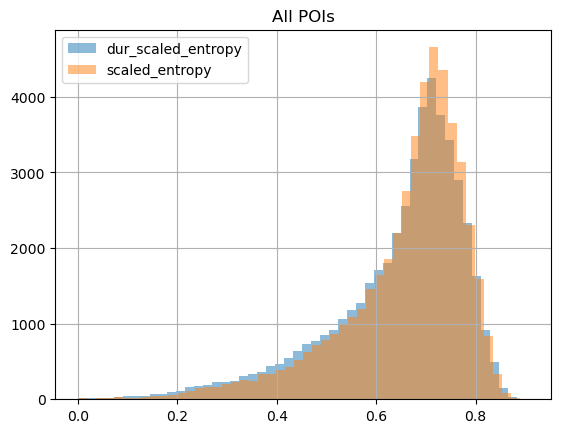

In [20]:
plot_hist(df_diversity1,'All POIs')

In [11]:
# #5812.0 Eating Places,  5411.0 Grocery Stores, 7991.0 Physical Fitness Facilities
# #7231.0 Beauty Shops, 6021.0 National Commercial Banks, 7011.0 Hotels and Motels 5311.0
# plot_hist(df_diversity1[df_diversity1.sic_code==5812],'Restaurant')
# plot_hist(df_diversity1[df_diversity1.sic_code==5411],'Grocery Store')
# plot_hist(df_diversity1[df_diversity1.sic_code==7991],'Physical Fitness Facilities')

In [22]:
df_diversity1['equal'] = df_diversity1['class_dominant'] == df_diversity1['dur_class_dominant']
print('total POI:',df_diversity1.shape[0])
print('POIs that show different dominant diversity type:',df_diversity1[df_diversity1['equal']!=True].shape[0])
print(df_diversity1[df_diversity1['equal']!=True].shape[0]/df_diversity1.shape[0])
display(df_diversity1[df_diversity1['equal']!=True].head())

total POI: 48731
POIs that show different dominant diversity type: 8174
0.167737169358314


,place_id,scaled_entropy,class_dominant,dur_scaled_entropy,dur_class_dominant,poi_lat,poi_lng,brand_name,sic_code,sic_name,equal
2,25033570.0,0.789457,high diversity,0.739927,R_HispanicLatinx_moderate diversity,34.146588,-118.157044,Porsche,5511.0,Motor Vehicle Dealers (New and Used),False
4,25033586.0,0.566989,R_HispanicLatinx_moderate diversity,0.257862,R_HispanicLatinx_low diversity,33.790930,-118.143355,Porsche,5511.0,Motor Vehicle Dealers (New and Used),False
15,25034318.0,0.741524,high diversity,0.672182,R_Asian_moderate diversity,34.145371,-118.136474,Charles Schwab,6211.0,"Security Brokers, Dealers, and Flotation Companies",False
19,25034767.0,0.606181,R_HispanicLatinx_moderate diversity,0.671381,R_White_moderate diversity,34.421464,-118.558355,MINI,5511.0,Motor Vehicle Dealers (New and Used),False
27,25036870.0,0.744896,high diversity,0.741694,R_Asian_moderate diversity,34.001919,-117.808947,Crunch Fitness,7991.0,Physical Fitness Facilities,False


In [25]:
df_diversity1['diff_entropy'] = (df_diversity1['dur_scaled_entropy'] - df_diversity1['scaled_entropy'])/df_diversity1['scaled_entropy']
# sns.violinplot(data=df_diversity1, x='diff_entropy',orient="h")
df_diversity1['diff_entropy'].hist(bins=100)

# diversity by POI type

In [26]:
test_poi_cat_list = [5812,5411,7991,7231,6021,7011,5311]
#5812.0 Eating Places,  5411.0 Grocery Stores, 7991.0 Physical Fitness Facilities
#7231.0 Beauty Shops, 6021.0 National Commercial Banks, 7011.0 Hotels and Motels 5311.0

In [31]:
plt_data.head()

,place_id,scaled_entropy,class_dominant,dur_scaled_entropy,dur_class_dominant,poi_lat,poi_lng,brand_name,sic_code,sic_name,equal,diff_entropy
25,25036812.0,0.589322,R_HispanicLatinx_moderate diversity,0.591954,R_HispanicLatinx_moderate diversity,34.578801,-118.089164,Crunch Fitness,7991.0,Physical Fitness Facilities,True,0.004467
26,25036818.0,0.806623,high diversity,0.796996,high diversity,33.846938,-118.080288,Crunch Fitness,7991.0,Physical Fitness Facilities,True,-0.011936
27,25036870.0,0.744896,high diversity,0.741694,R_Asian_moderate diversity,34.001919,-117.808947,Crunch Fitness,7991.0,Physical Fitness Facilities,False,-0.004299
28,25036890.0,0.779440,R_HispanicLatinx_moderate diversity,0.757168,R_HispanicLatinx_moderate diversity,33.861088,-118.126159,Crunch Fitness,7991.0,Physical Fitness Facilities,True,-0.028575
29,25036901.0,0.694678,R_HispanicLatinx_moderate diversity,0.697541,R_HispanicLatinx_moderate diversity,34.118179,-117.775074,Crunch Fitness,7991.0,Physical Fitness Facilities,True,0.004122


In [32]:
melted_plt_data.head()

,sic_name,Value Type,Scaled Entropy
0,Physical Fitness Facilities,scaled_entropy,0.589322
1,Physical Fitness Facilities,scaled_entropy,0.806623
2,Physical Fitness Facilities,scaled_entropy,0.744896
3,Physical Fitness Facilities,scaled_entropy,0.779440
4,Physical Fitness Facilities,scaled_entropy,0.694678


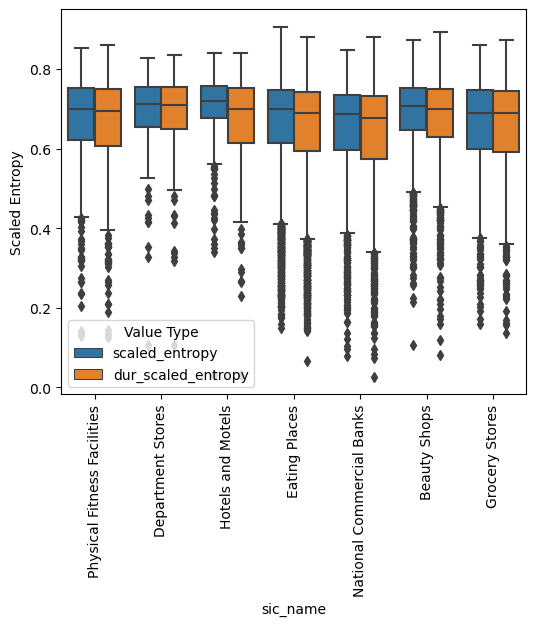

In [27]:
# sns.violinplot(data=sub_df_visit_LA_race2, x='scaled_entropy', y='sic_name',orient="h")
plt_data = df_diversity1[df_diversity1.sic_code.isin(test_poi_cat_list)]
fig, ax = plt.subplots(figsize=(6,5))
melted_plt_data = pd.melt(plt_data, id_vars='sic_name', value_vars=['scaled_entropy', 'dur_scaled_entropy'],
                    var_name='Value Type', value_name='Scaled Entropy')
ax = sns.boxplot(data=melted_plt_data, x='sic_name', y='Scaled Entropy',hue='Value Type', orient="v")
# ax.set_title('Racial diversity based on proportions')
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.show()

# Mapping
generate config file: https://kepler.gl/demo/earthquakes

In [14]:
%%time

sub_df_visit_LA_race_poi = pd.read_pickle("../output/LA_POI_diversity_201903_weekend.pkl")  
sub_df_visit_LA_race_poi = sub_df_visit_LA_race_poi[sub_df_visit_LA_race_poi['class_dominant']!='R_Other_moderate diversity']
k3 = KeplerGl(data={'h':sub_df_visit_LA_race_poi}, height=700)
with open('config/visit_poi.py', 'r') as config_file:
    k3.config = json.loads(config_file.read())
k3 

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
CPU times: user 1.69 s, sys: 58.5 ms, total: 1.75 s
Wall time: 1.75 s


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'hty62yd', 'type': …

In [11]:
sub_df_visit_LA_race2 = sub_df_visit_LA_race_poi[sub_df_visit_LA_race_poi.sic_code.isin(test_poi_cat_list)]
sub_df_visit_LA_race2.sic_name.unique()

array(['Physical Fitness Facilities', 'Department Stores',
       'Hotels and Motels', 'Eating Places', 'National Commercial Banks',
       'Beauty Shops', 'Grocery Stores'], dtype=object)

In [12]:
%%time
k = KeplerGl(data={'h':sub_df_visit_LA_race2[sub_df_visit_LA_race2['sic_name']=='Eating Places']}, height=700) 
with open('config/visit_poi_restaurant.py', 'r') as config_file:
    k.config = json.loads(config_file.read())
k 

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
CPU times: user 146 ms, sys: 11.6 ms, total: 158 ms
Wall time: 155 ms


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'hty62yd', 'type': …

In [18]:
# %%time
# k2 = KeplerGl(data={'h':df_duration_byrace_diversity}, height=700) 
# with open('config/visit_poi.py', 'r') as config_file:
#     k2.config = json.loads(config_file.read())
# k2

# Check those POIs that shift their categories in CEUS paper

In [2]:
weekday = pd.read_pickle("../output/LA_POI_diversity_201903_weekday.pkl")  
print(weekday.shape[0])
print(weekday.place_id.unique().shape[0])

34204
34204


In [3]:
weekend = pd.read_pickle("../output/LA_POI_diversity_201903_weekend.pkl")  
print(weekend.shape[0])
print(weekend.place_id.unique().shape[0])

31381
31381


In [4]:
print(weekday.class_dominant.value_counts())
round(weekday['class_dominant'].value_counts() / len(weekday) * 100,2)

R_HispanicLatinx_moderate diversity     16113
R_White_moderate diversity              8078 
high diversity                          6988 
R_HispanicLatinx_low diversity          1806 
R_Asian_moderate diversity              916  
R_AfricanAmerican_moderate diversity    233  
R_White_low diversity                   51   
R_Asian_low diversity                   11   
R_AfricanAmerican_low diversity         7    
R_Other_moderate diversity              1    
Name: class_dominant, dtype: int64


R_HispanicLatinx_moderate diversity     47.11
R_White_moderate diversity              23.62
high diversity                          20.43
R_HispanicLatinx_low diversity          5.28 
R_Asian_moderate diversity              2.68 
R_AfricanAmerican_moderate diversity    0.68 
R_White_low diversity                   0.15 
R_Asian_low diversity                   0.03 
R_AfricanAmerican_low diversity         0.02 
R_Other_moderate diversity              0.00 
Name: class_dominant, dtype: float64

In [5]:
print(weekend.class_dominant.value_counts())
round(weekend['class_dominant'].value_counts() / len(weekend) * 100,2)

R_HispanicLatinx_moderate diversity     14157
R_White_moderate diversity              7793 
high diversity                          6041 
R_HispanicLatinx_low diversity          2057 
R_Asian_moderate diversity              905  
R_AfricanAmerican_moderate diversity    278  
R_White_low diversity                   121  
R_Asian_low diversity                   17   
R_AfricanAmerican_low diversity         12   
Name: class_dominant, dtype: int64


R_HispanicLatinx_moderate diversity     45.11
R_White_moderate diversity              24.83
high diversity                          19.25
R_HispanicLatinx_low diversity          6.55 
R_Asian_moderate diversity              2.88 
R_AfricanAmerican_moderate diversity    0.89 
R_White_low diversity                   0.39 
R_Asian_low diversity                   0.05 
R_AfricanAmerican_low diversity         0.04 
Name: class_dominant, dtype: float64

In [6]:
print(weekday.scaled_entropy.mean())
weekend.scaled_entropy.mean()

0.6558653113910233


0.6446217776466383

In [7]:
from scipy.stats import mannwhitneyu

statistic, p_value = mannwhitneyu(weekday.scaled_entropy, weekend.scaled_entropy)
# Print the test statistic and p-value
print("Mann-Whitney U statistic:", statistic)
print("p-value:", round(p_value,3))

Mann-Whitney U statistic: 558155371.0
p-value: 0.0


In [8]:
weekday_select = weekday[['place_id','poi_lat','poi_lng','class_dominant','brand_name','sic_code','sic_name']]
weekday_select = weekday_select.rename(columns={"class_dominant": "class_dominant_weekday"})
weekend_select = weekend[['place_id','class_dominant']]
weekend_select = weekend_select.rename(columns={"class_dominant": "class_dominant_weekend"})
print(weekday_select.shape[0], weekend_select.shape[0])

34204 31381


In [9]:
diff_compare = weekday_select.merge(weekend_select, left_on='place_id', right_on='place_id')
print(diff_compare.shape[0])

30928


In [10]:
diff_compare['check'] = diff_compare['class_dominant_weekday'] == diff_compare['class_dominant_weekend']
diff_compare_common = diff_compare[diff_compare['check']==False]
print(diff_compare_common.shape[0])

9191


In [11]:
diff_compare_common['class_dominant'] = diff_compare_common['class_dominant_weekday'] + ' to ' + diff_compare_common['class_dominant_weekend']
diff_compare_common['class_dominant'].value_counts()

R_HispanicLatinx_moderate diversity to high diversity                          1535
high diversity to R_HispanicLatinx_moderate diversity                          1466
high diversity to R_White_moderate diversity                                   1185
R_HispanicLatinx_moderate diversity to R_White_moderate diversity              954 
R_White_moderate diversity to R_HispanicLatinx_moderate diversity              826 
R_HispanicLatinx_moderate diversity to R_HispanicLatinx_low diversity          810 
R_White_moderate diversity to high diversity                                   791 
R_HispanicLatinx_low diversity to R_HispanicLatinx_moderate diversity          384 
R_HispanicLatinx_moderate diversity to R_Asian_moderate diversity              209 
R_Asian_moderate diversity to R_HispanicLatinx_moderate diversity              179 
high diversity to R_Asian_moderate diversity                                   153 
R_HispanicLatinx_moderate diversity to R_AfricanAmerican_moderate diversity 

In [12]:
round(diff_compare_common['class_dominant'].value_counts() / len(diff_compare_common) * 100,2)

R_HispanicLatinx_moderate diversity to high diversity                          16.70
high diversity to R_HispanicLatinx_moderate diversity                          15.95
high diversity to R_White_moderate diversity                                   12.89
R_HispanicLatinx_moderate diversity to R_White_moderate diversity              10.38
R_White_moderate diversity to R_HispanicLatinx_moderate diversity              8.99 
R_HispanicLatinx_moderate diversity to R_HispanicLatinx_low diversity          8.81 
R_White_moderate diversity to high diversity                                   8.61 
R_HispanicLatinx_low diversity to R_HispanicLatinx_moderate diversity          4.18 
R_HispanicLatinx_moderate diversity to R_Asian_moderate diversity              2.27 
R_Asian_moderate diversity to R_HispanicLatinx_moderate diversity              1.95 
high diversity to R_Asian_moderate diversity                                   1.66 
R_HispanicLatinx_moderate diversity to R_AfricanAmerican_moderate

In [26]:
%%time

k = KeplerGl(data={'h':diff_compare_common[diff_compare_common['class_dominant'].isin(['high diversity to R_HispanicLatinx_moderate diversity',
                                                                                       'R_HispanicLatinx_moderate diversity to high diversity'])]}, height=700)
with open('config/visit_poi_shifted.py', 'r') as config_file:
    k.config = json.loads(config_file.read())
k

In [92]:
%%time

k = KeplerGl(data={'h':diff_compare_common[diff_compare_common['class_dominant'].isin(['high diversity to R_White_moderate diversity',
                                                                                       'R_White_moderate diversity to high diversity'])]}, height=700)
with open('config/visit_poi_shifted.py', 'r') as config_file:
    k.config = json.loads(config_file.read())
k

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
CPU times: user 33 ms, sys: 0 ns, total: 33 ms
Wall time: 31.5 ms


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'hty62yd', 'type': …

In [23]:
%%time

k = KeplerGl(data={'h':diff_compare_common[diff_compare_common['class_dominant'].isin(['R_HispanicLatinx_moderate diversity to R_White_moderate diversity',
                                                                                       'R_White_moderate diversity to R_HispanicLatinx_moderate diversity'])]}, height=700)
with open('config/visit_poi_shifted.py', 'r') as config_file:
    k.config = json.loads(config_file.read())
k

In [12]:
%%time

k = KeplerGl(data={'h':diff_compare_common[diff_compare_common['class_dominant'].isin(['high diversity to R_Asian_moderate diversity',
                                                                                       'R_Asian_moderate diversity to high diversity'])]}, height=700)
# 'high diversity to R_Asian_moderate diversity','R_Asian_moderate diversity to high diversity'
#
with open('config/visit_poi_shifted.py', 'r') as config_file:
    k.config = json.loads(config_file.read())
k

In [13]:
# %%time

# k = KeplerGl(data={'h':diff_compare_common[diff_compare_common['class_dominant'].isin(['R_HispanicLatinx_moderate diversity to R_HispanicLatinx_low diversity',
#                                                                                        'R_HispanicLatinx_low diversity to R_HispanicLatinx_moderate diversity'])]}, height=700)
# with open('config/visit_poi_shifted.py', 'r') as config_file:
#     k.config = json.loads(config_file.read())
# k

In [12]:
import folium
from folium.plugins import HeatMap

In [30]:
# sub1 = diff_compare_common[diff_compare_common['class_dominant'].isin(['R_White_moderate diversity to R_HispanicLatinx_moderate diversity'])]
# print(sub1.sic_name.value_counts())
# print(round(sub1.sic_name.value_counts() / len(sub1) * 100,2)) #Eating Places, Radiotelephone Communications, Auto and Home Supply Stores

In [80]:
sub1 = diff_compare_common[diff_compare_common['class_dominant'].isin(['R_HispanicLatinx_moderate diversity to R_White_moderate diversity'])]
m = folium.Map(location=[34.11991, -118.090871], zoom_start=10, tiles="CartoDB positron")
HeatMap(sub1[['poi_lat','poi_lng']],radius=13,min_opacity=0.3).add_to(m)
m

In [81]:
sub1 = diff_compare_common[diff_compare_common['class_dominant'].isin(['R_White_moderate diversity to R_HispanicLatinx_moderate diversity'])]
m = folium.Map(location=[34.11991, -118.090871], zoom_start=10, tiles="CartoDB positron")
HeatMap(sub1[['poi_lat','poi_lng']],radius=13,min_opacity=0.3).add_to(m)
m